## Project Title: Bank Marketing Effectiveness Prediction

- **Project Type**: Supervised Learning (Classification)
- **Role**: Individual Contributor
- **Name**: Aryan Agarwal

### Problem Statement
A Portuguese bank conducted a phone-based marketing campaign, with campaign outcomes now available in a dataset. The objective is to apply machine learning methods to analyze this data and identify the most successful strategies for persuading more clients to subscribe to the bank’s term deposit product in future campaigns.

Because bank profitability heavily relies on long-term deposits, marketing teams are focused on direct client interactions that promote these products. By analyzing campaign performance, we aim to optimize outreach strategies, boosting successful client engagement while making the best use of limited marketing resources.

### Project Summary
To support cash reserves, banks rely on term deposits, which provide stable, long-term income. Thus, marketing professionals are under pressure to increase public interest in these deposits. Effective resource allocation is essential, with a focus on minimizing unnecessary calls while maximizing successful conversions. 

Using past campaign data, classification models can help predict the likelihood of a positive client response in future outreach efforts. This data is often imbalanced, as a smaller percentage of clients typically respond positively to such campaigns. Efficient client targeting is therefore crucial for managing resources, reducing costs, and enhancing the overall response rate. Machine learning models will play a pivotal role in identifying clients with a higher likelihood of engagement, allowing teams to allocate resources more effectively.

### Objective
The primary goal of this project is to develop a predictive model that can determine whether a new client will subscribe to a term deposit based on data from previous marketing campaigns.

### Project Workflow

1. **Library Imports**  
   Import necessary libraries for data processing and model development.

2. **Data Wrangling**
   - **Data Collection**: Gather the dataset for analysis.
   - **Data Assessment**: Evaluate data quality and identify any issues.
   - **Data Cleaning**: Handle missing values, correct data types, and prepare the data for analysis.

3. **Exploratory Data Analysis (EDA)**
   - **Univariate Analysis**: Study each feature individually.
   - **Bivariate Analysis**: Examine relationships between pairs of variables.
   - **Multivariate Analysis**: Analyze interactions among multiple variables to uncover deeper insights.

4. **Feature Engineering**
   - **Outlier Detection**: Identify and handle outliers to improve model accuracy.
   - **Feature Transformation**: Apply necessary transformations to optimize feature performance.
   - **Feature Selection**: Identify and retain only the most impactful features for the model.

5. **Multicollinearity Check**
   - Remove highly correlated features to reduce redundancy and improve model stability.

6. **Data Pre-processing**
   - **Column Preprocessing**: Process columns for model compatibility.
   - **Variable Splitting**: Separate dependent and independent variables.
   - **Class Imbalance Handling**: Address class imbalance issues to improve model fairness and accuracy.

7. **Model Development and Hyperparameter Tuning**
   - **Train-Test Split**: Split the data into training and testing sets.
   - **Algorithm Pipeline**: Develop pipelines to test various machine learning algorithms.
   - **Hyperparameter Tuning**: Optimize model performance by fine-tuning parameters.

8. **Model Selection**
   - Choose the model that delivers the highest accuracy and meets project objectives.

### Conclusion
The final model will help the bank target clients more likely to subscribe to term deposits, enabling a more efficient and effective marketing approach in future campaigns.



## Importing  Libraries

In [3]:
# Data manipulation libraries
import pandas as pd
import numpy as np

# Data visualization libraries
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go


# setting style and rcparams
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (7,4)
matplotlib.rcParams['figure.facecolor'] = '#00000000'
plt.rcParams["font.family"] = "Arial"

# for remove Multicollinearity
from statsmodels.stats.outliers_influence import variance_inflation_factor

# for handling class imbalance
from imblearn.over_sampling import SMOTE

# Preprocessing libraries
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import FunctionTransformer
from sklearn.preprocessing import PowerTransformer

# for model implementation
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import BernoulliNB
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier


# For build pipeline
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline

# Model selection libraries
from sklearn.model_selection import cross_validate
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RandomizedSearchCV

# for performance metrics
from sklearn import metrics
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score
from sklearn.metrics import accuracy_score, roc_auc_score, roc_curve, log_loss, precision_score, f1_score, recall_score, auc

In [6]:
df = pd.read_csv("Dataset/bank_dataset.csv")

In [8]:
df.sample(10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
27551,43,technician,married,secondary,no,3288,yes,no,cellular,21,nov,775,3,-1,0,unknown,yes
35156,31,self-employed,single,tertiary,no,253,yes,no,cellular,7,may,157,1,349,4,failure,no
20641,54,admin.,married,secondary,no,4943,no,no,cellular,12,aug,145,11,-1,0,unknown,no
15341,47,admin.,married,secondary,no,26,no,yes,cellular,18,jul,71,3,-1,0,unknown,no
19347,46,technician,single,tertiary,no,3133,no,no,cellular,6,aug,411,3,-1,0,unknown,no
9507,35,services,single,secondary,no,-2,no,no,unknown,6,jun,15,1,-1,0,unknown,no
3760,28,services,single,secondary,no,45,yes,no,unknown,16,may,345,1,-1,0,unknown,no
44017,57,unknown,married,primary,no,1884,no,no,telephone,28,jun,133,4,-1,0,unknown,no
32953,32,technician,married,secondary,no,4887,yes,no,cellular,17,apr,246,3,-1,0,unknown,no
36945,53,admin.,divorced,secondary,no,28,yes,yes,cellular,12,may,673,4,-1,0,unknown,no


In [10]:
df.shape

(45211, 17)

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        45211 non-null  int64 
 1   job        45211 non-null  object
 2   marital    45211 non-null  object
 3   education  45211 non-null  object
 4   default    45211 non-null  object
 5   balance    45211 non-null  int64 
 6   housing    45211 non-null  object
 7   loan       45211 non-null  object
 8   contact    45211 non-null  object
 9   day        45211 non-null  int64 
 10  month      45211 non-null  object
 11  duration   45211 non-null  int64 
 12  campaign   45211 non-null  int64 
 13  pdays      45211 non-null  int64 
 14  previous   45211 non-null  int64 
 15  poutcome   45211 non-null  object
 16  y          45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


In [16]:
df.duplicated().sum()

0

In [22]:
df.isna().sum()

age          0
job          0
marital      0
education    0
default      0
balance      0
housing      0
loan         0
contact      0
day          0
month        0
duration     0
campaign     0
pdays        0
previous     0
poutcome     0
y            0
dtype: int64

In [24]:
df.describe()

,age,balance,day,duration,campaign,pdays,previous
count,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000
mean,40.936210,1362.272058,15.806419,258.163080,2.763841,40.197828,0.580323
std,10.618762,3044.765829,8.322476,257.527812,3.098021,100.128746,2.303441
min,18.000000,-8019.000000,1.000000,0.000000,1.000000,-1.000000,0.000000
25%,33.000000,72.000000,8.000000,103.000000,1.000000,-1.000000,0.000000
50%,39.000000,448.000000,16.000000,180.000000,2.000000,-1.000000,0.000000
75%,48.000000,1428.000000,21.000000,319.000000,3.000000,-1.000000,0.000000
max,95.000000,102127.000000,31.000000,4918.000000,63.000000,871.000000,275.000000


In [26]:
df["y"].value_counts()

y
no     39922
yes     5289
Name: count, dtype: int64

**Note:**

The target variable in this dataset is highly imbalanced, with a low proportion of positive responses ("yes") compared to negative responses ("no"). This pattern is common in marketing campaigns, where typically only a small fraction of the audience shows interest in the offered product—in this case, a term deposit. However, the substantial overrepresentation of "no" responses compared to "yes" responses indicates a class imbalance. It is essential to address this imbalance when developing predictive models to ensure more accurate and reliable results.


## Data Cleaning


In [30]:
df_copy = df.copy()

In [36]:
cat_cols = df_copy.select_dtypes(include = 'object').columns
df_copy[cat_cols] = df_copy[cat_cols].astype('category')
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype   
---  ------     --------------  -----   
 0   age        45211 non-null  int64   
 1   job        45211 non-null  category
 2   marital    45211 non-null  category
 3   education  45211 non-null  category
 4   default    45211 non-null  category
 5   balance    45211 non-null  int64   
 6   housing    45211 non-null  category
 7   loan       45211 non-null  category
 8   contact    45211 non-null  category
 9   day        45211 non-null  int64   
 10  month      45211 non-null  category
 11  duration   45211 non-null  int64   
 12  campaign   45211 non-null  int64   
 13  pdays      45211 non-null  int64   
 14  previous   45211 non-null  int64   
 15  poutcome   45211 non-null  category
 16  y          45211 non-null  category
dtypes: category(10), int64(7)
memory usage: 2.8 MB


In [46]:
df_copy[df_copy['balance']<=0].value_counts().sum()

7280

In [50]:
df_copy[(df_copy['balance']<= 0) & (df_copy['y']=="yes")].value_counts().sum()

502

It is unusual to find that there are 7,280 customers with either a zero or negative bank balance who also have housing loans, personal loans, or credit in default. Among these, 502 customers indicated they would subscribe to a term deposit. Given the atypical nature of these records, they will be removed from the dataset.


In [57]:
df_copy = df_copy.drop(df_copy[(df_copy['balance']<= 0) & (df_copy['y']=="yes")].index)

In [59]:
df_copy.shape

(44709, 17)

## Exploratory Data Analysis

In [64]:
categorical = [col for col in df_copy.columns if (df_copy[col].dtypes == 'category')]
categorical

['job',
 'marital',
 'education',
 'default',
 'housing',
 'loan',
 'contact',
 'month',
 'poutcome',
 'y']

In [66]:
num = [col for col in df_copy.columns if (df_copy[col].dtypes == "int64")]

In [68]:
num

['age', 'balance', 'day', 'duration', 'campaign', 'pdays', 'previous']

## Univariate and Bivariate Analysis

### Categorical variables 

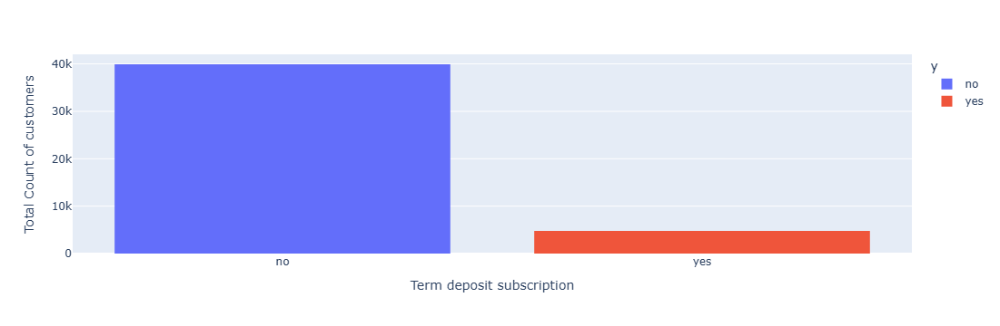

In [72]:
fig = px.histogram(df_copy,x="y", color = "y")
fig.update_layout(xaxis_title = 'Term deposit subscription',yaxis_title='Total Count of customers')
fig.show()

**Observations:**

Upon analyzing the target column "y" (term deposit subscription), we observed a significant imbalance between the number of customers who subscribed to the term deposit and those who did not. The ratio of non-subscribed to subscribed customers is 88:12, indicating that the bank invested a considerable amount of time, resources, and manpower without achieving the desired outcome. To address this challenge, we are building a predictive model capable of efficiently identifying potential customers who are likely to subscribe to the term deposit, thereby saving time and resources.

However, the dataset is imbalanced, which may affect the accuracy of the predictive model. To mitigate this issue, we are implementing various feature engineering techniques aimed at balancing the dataset and improving model performance.


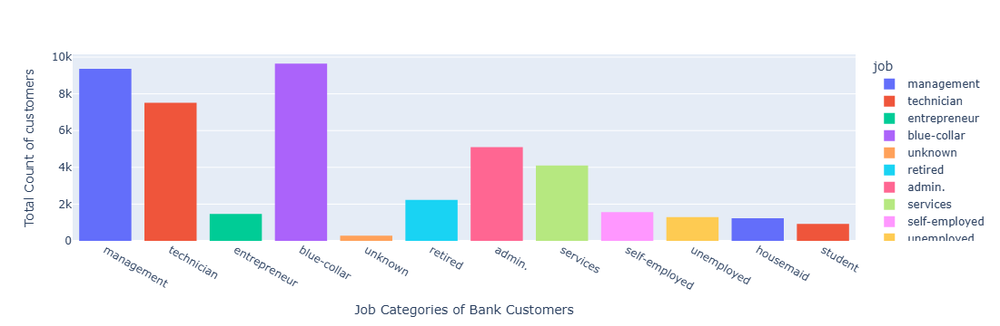

In [77]:
fig = px.histogram(df_copy,x="job",color="job")
fig.update_layout(xaxis_title='Job Categories of Bank Customers',yaxis_title='Total Count of customers')
fig.show()

**Observations:**

Based on the visualization of job categories of bank customers, it is evident that the bank tends to target customers with job roles such as management, blue-collar, technician, admin, and services. Conversely, customers with job roles like entrepreneurs, self-employed, unemployed, students, and housemaids are less likely to be targeted by the bank.

This observation aligns with the expectation that job roles such as management, blue-collar, technician, admin, and services are more likely to provide steady income and financial stability, making these individuals ideal candidates for bank services such as loans, credit cards, and other financial products. In contrast, job roles like self-employed, unemployed, and students are less likely to offer consistent income, which makes them less attractive to the bank for targeted financial products.


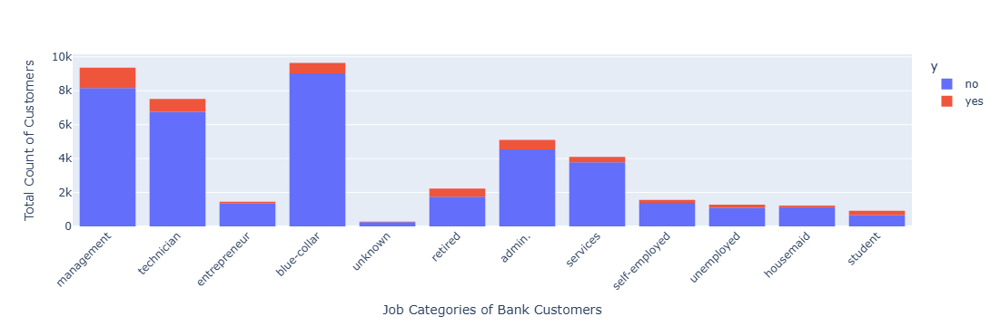

In [80]:
fig = px.histogram (df_copy , x="job", color = "y")
fig.update_layout(xaxis_title='Job Categories of Bank Customers',yaxis_title='Total Count of Customers',xaxis_tickangle=-45)
fig.show()

**Observations:**

The histogram of job categories for bank customers reveals that the bank primarily targets customers in job categories such as management, blue-collar, technician, admin, and services, while fewer customers in job categories like entrepreneurs, self-employed, unemployed, students, and housemaids are contacted. Interestingly, customers in the "students" and "retired" job categories have a higher subscription rate to term deposits compared to other job categories.

Based on this, the bank should consider focusing more on job categories such as students and retired individuals to increase the term deposit subscription rate.


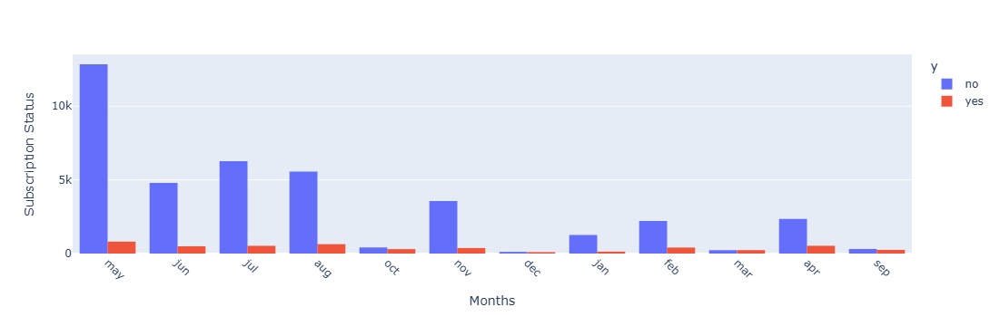

In [89]:
fig = px.histogram(df_copy , x="month",color = "y", barmode = "group")
fig.update_layout(xaxis_title = "Months", yaxis_title = "Subscription Status", xaxis_tickangle = 45)
fig.show()


**Observations:**

We observe that the subscription rate is low during the months of September, October, December, January, and March, and the number of customer contacts is also low during these months. However, the subscription rate is relatively better compared to the number of customer contacts in these months. To improve the subscription rate, the bank should focus on increasing customer contacts during these months and encourage customers to subscribe to the term deposit.

For the remaining months, the subscription rate is generally low, regardless of the number of customer contacts made. This indicates that the bank needs to enhance its marketing strategy and promotion of term deposit subscriptions to attract more customers.


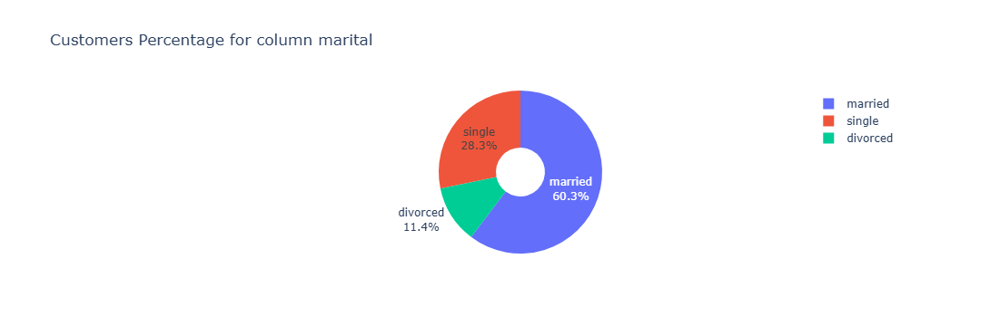

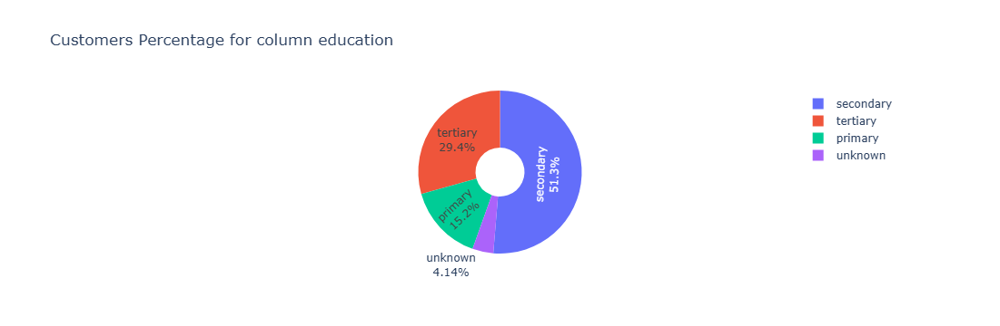

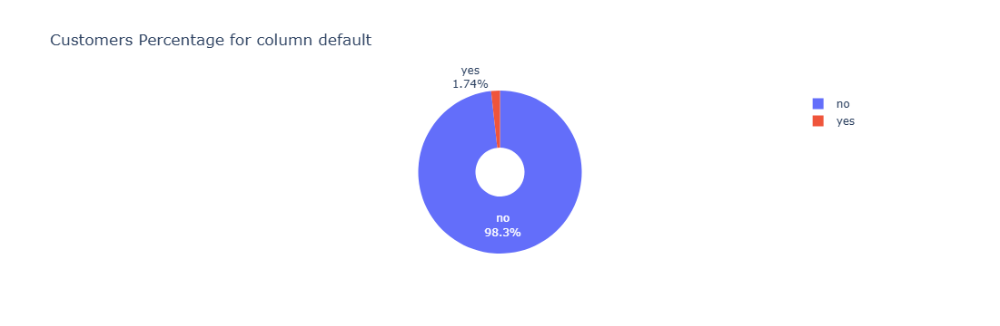

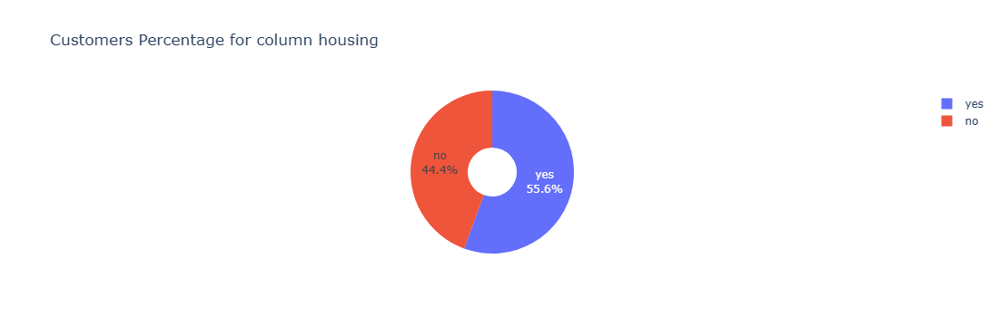

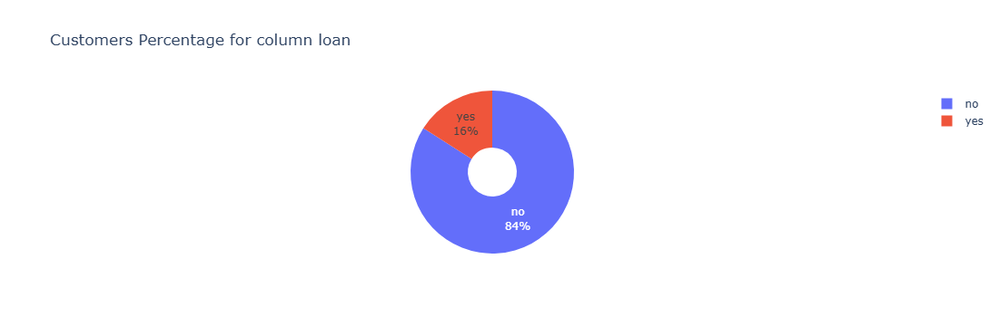

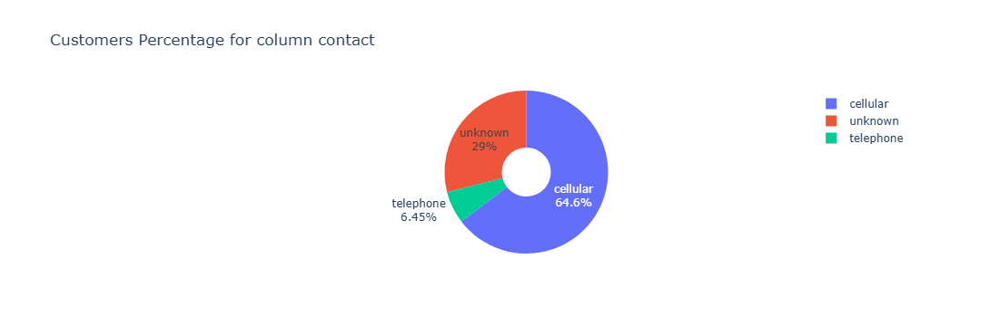

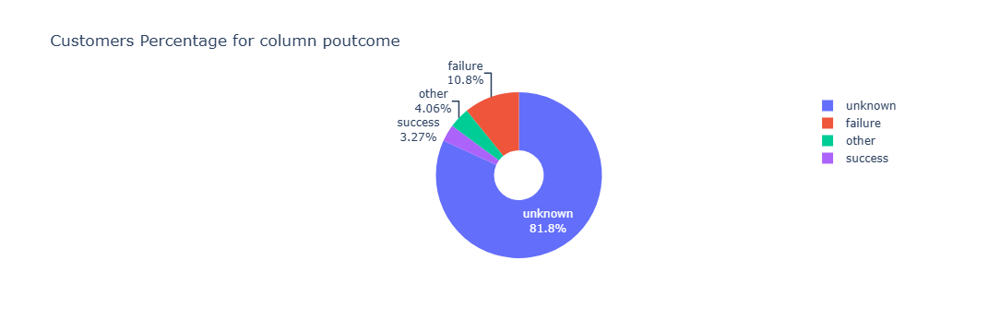

In [94]:
categorical = ['marital', 'education', 'default', 'housing', 'loan', 'contact', 'poutcome']

for column in categorical:
    fig = px.pie(df_copy, names=column, title=f"Customers Percentage for column {column}", 
                 hole=0.3, color_discrete_sequence=px.colors.qualitative.Plotly)
    fig.update_traces(textinfo='percent+label')
    fig.show()
     

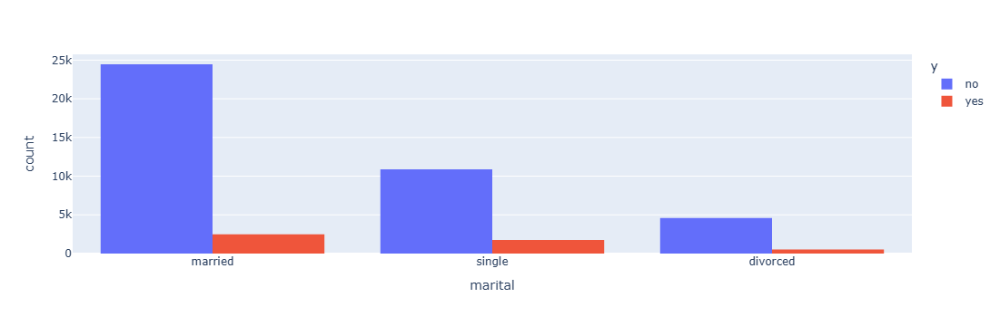

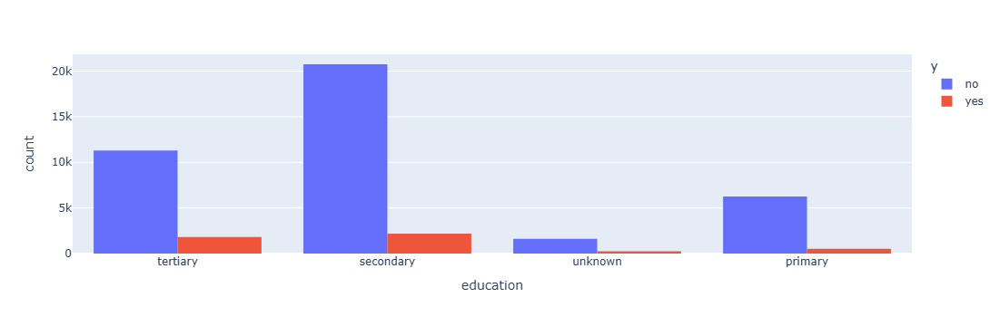

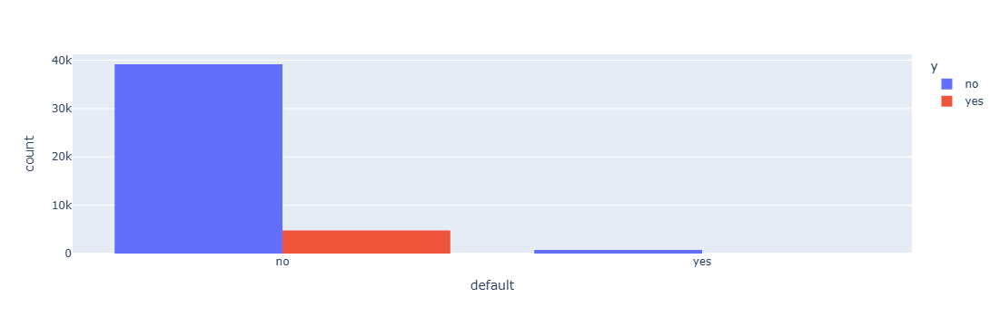

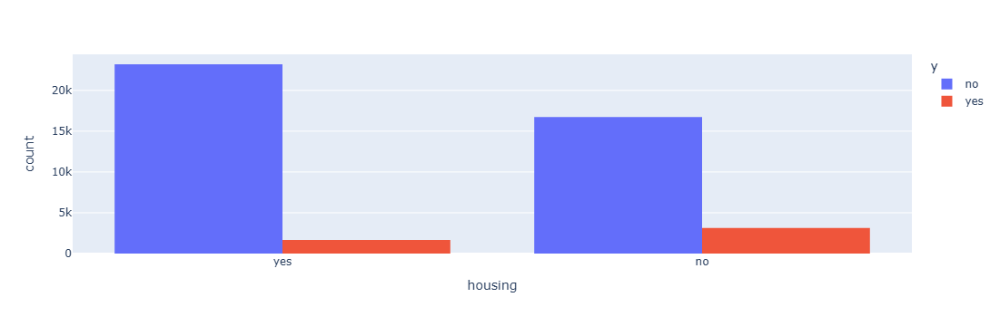

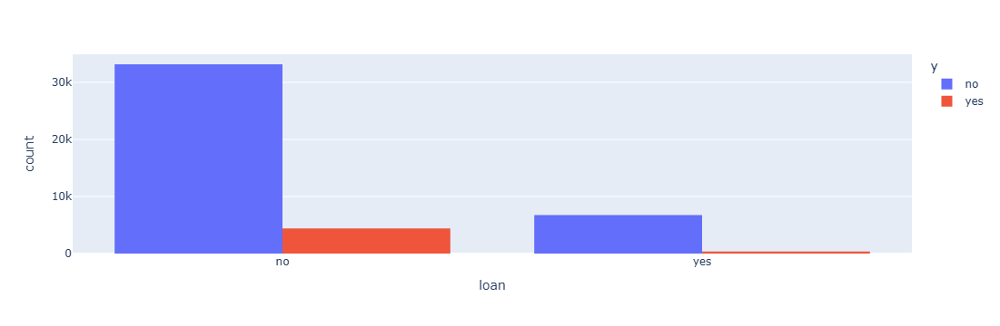

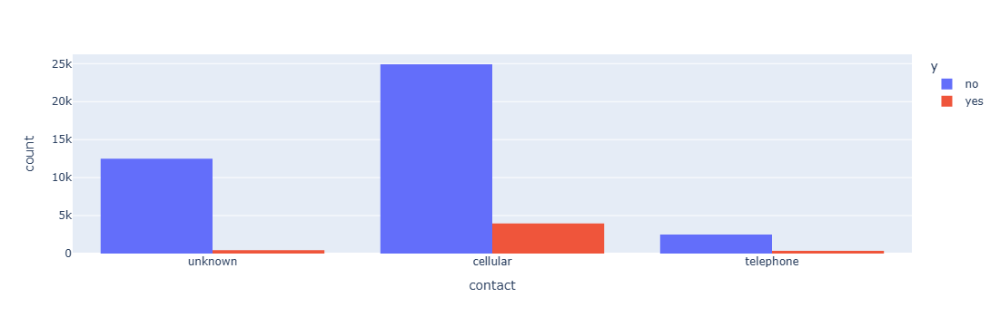

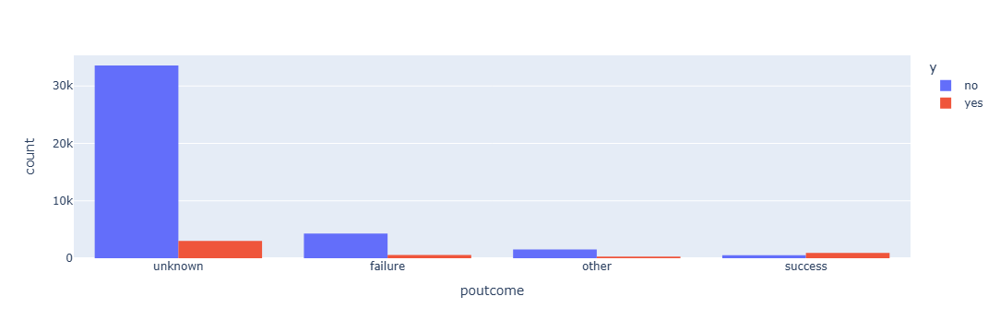

In [96]:
categorical = ['marital', 'education', 'default', 'housing', 'loan', 'contact', 'poutcome']
for col in categorical:
    fig = px.histogram(df_copy, x = col,color='y',barmode = "group")
    fig.update_layout(xaxis_title = col)
    fig.show()

**Observations:**

- Customers who do not have any personal loans, housing loans, or credit defaults have a higher subscription rate to term deposits compared to those who have loans or credit defaults.
  
- In the education column, customers with secondary and tertiary education have a higher percentage of term deposit subscriptions. This suggests that the bank should focus more on targeting customers in these education categories.

- In the marital status column, there is no clear pattern in the subscription ratio. However, the bank should focus more on married and single customers who are students, as previous analysis indicated that students have a higher subscription rate in the job category.

- In the poutcome (previous outcome) column, customers who subscribed to term deposits in the previous marketing campaign are more likely to subscribe again. This indicates a higher chance of success in targeting these customers for future campaigns.


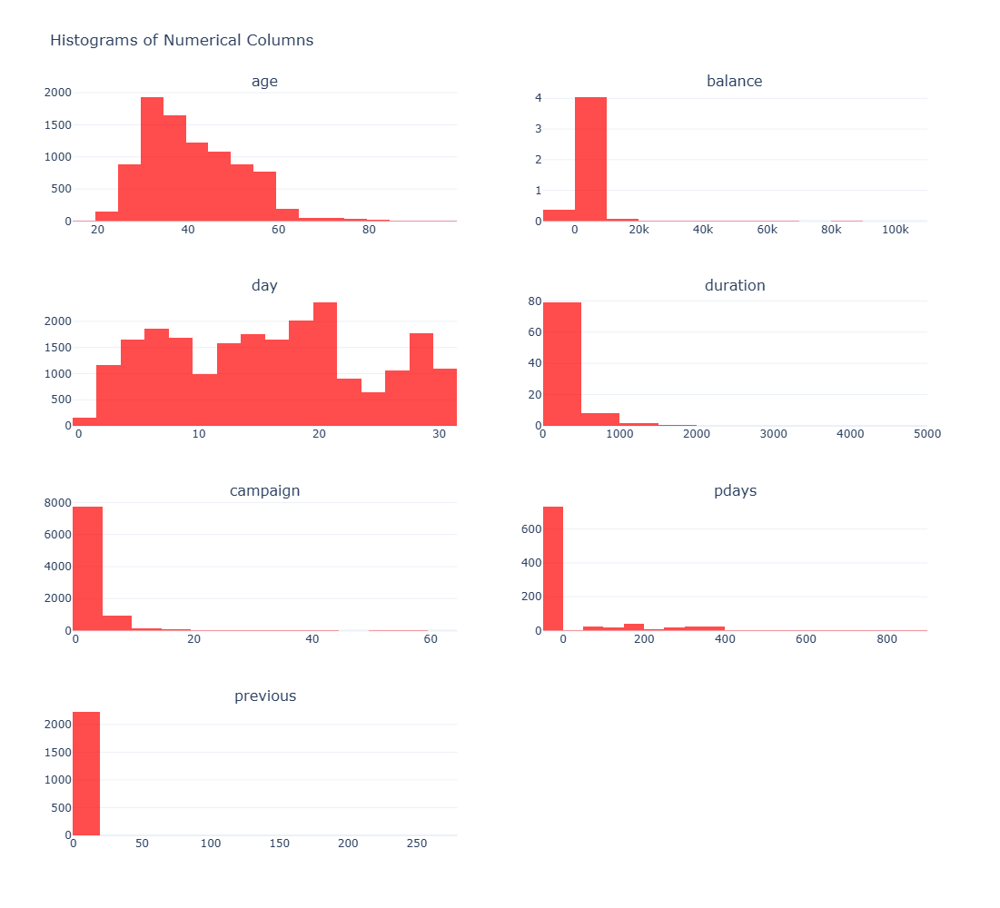

In [103]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the number of subplots
num_columns = len(num)
rows = 4  # You can adjust this depending on the number of columns
cols = 2  # Since you're displaying 8 charts in total

# Create a subplot grid
fig = make_subplots(
    rows=rows, cols=cols, 
    subplot_titles=num,
    vertical_spacing=0.1, horizontal_spacing=0.1
)

# Loop through numerical columns and add histograms to subplots
for i, col in enumerate(num):
    row = i // cols + 1  # Calculate row position
    col_pos = i % cols + 1  # Calculate column position
    
    # Create histogram for each column
    hist = go.Histogram(
        x=df_copy[col], 
        name=col, 
        nbinsx=20,  # Adjust the number of bins as needed
        marker=dict(color='red'),
        histnorm='density',  # To include a KDE-like plot
        opacity=0.7
    )
    
    # Add to subplot
    fig.add_trace(hist, row=row, col=col_pos)

# Update layout
fig.update_layout(
    height=1000,  # Set appropriate height
    width=1000,  # Set appropriate width
    title_text="Histograms of Numerical Columns",
    showlegend=False,
    template="plotly_white"
)

# Show the plot
fig.show()


## Feature Engineering

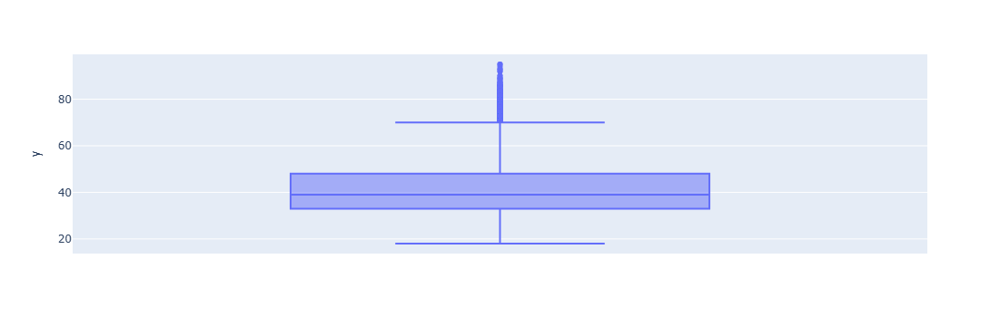

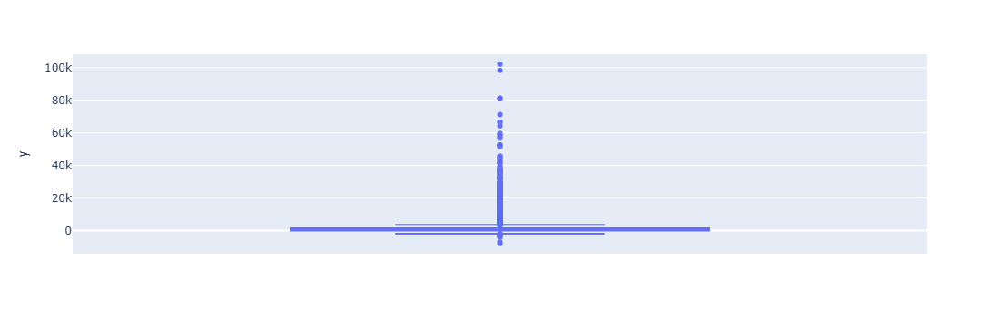

In [106]:
columns = ["age","balance"]
for col in columns :
    fig = px.box(y=df_copy[col])
    fig.show()

### Observations on Outliers

In these scenarios, it is not advisable to remove outliers from the dataset, as they contain valuable information that can help improve model accuracy. 

- **Bank Balance Column**: 
    - Some customers have high bank balances, while others have non-positive balances. If these outliers are removed, the model will lack critical information regarding these customers, which may lead to less accurate predictions. 
    - Removing such outliers could also risk overfitting the model, as the model would be trained on a less representative subset of data. 

- **Age Column**: 
    - Although there are outliers in the age column, such as very young or very old customers, they still play an important role in predicting term deposit subscriptions.
    - Removing outliers could lead to a loss of critical information that may help improve the model's predictive capability.

### Conclusion:
- It is important to **retain the outliers** in the dataset and use **robust algorithms** that can handle them effectively during model training. Since we are using robust algorithms, such as tree-based methods (like Random Forests or Gradient Boosting), the model is less sensitive to outliers, ensuring that we capture all valuable information without overfitting.


In [110]:
def job_cat(job):
    cat_1 = ['retired','student']
    cat_2 = ['blue-collar','management','technician','admin.','services']
    cat_3 = ['unemployed','housemaid','unknown']
    cat_4 = ['self-employed','entrepreneur']
    if job in cat_1 :
        return "cat_1"
    if job in cat_2 :
        return "cat_2"
    if job in cat_3 :
        return "cat_3"
    if job in cat_4 :
        return "cat_4"

In [112]:
df_copy["job_category"]= df_copy["job"].apply(job_cat)

In [116]:
df_copy.sample(10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y,job_category
41546,27,student,single,tertiary,no,-148,yes,no,cellular,11,sep,146,3,224,1,other,no,cat_1
16202,35,management,single,secondary,no,1031,yes,no,cellular,22,jul,254,1,-1,0,unknown,no,cat_2
30419,52,unemployed,married,secondary,no,-307,no,no,cellular,5,feb,272,1,-1,0,unknown,no,cat_3
26317,43,blue-collar,single,primary,no,13620,yes,no,cellular,20,nov,128,1,-1,0,unknown,no,cat_2
43853,28,blue-collar,single,secondary,no,75,no,no,unknown,1,jun,7,1,-1,0,unknown,no,cat_2
25912,52,self-employed,divorced,secondary,no,1291,yes,no,cellular,19,nov,559,1,169,2,failure,no,cat_4
5027,38,management,married,tertiary,no,126,yes,no,unknown,21,may,164,2,-1,0,unknown,no,cat_2
12189,33,blue-collar,single,secondary,no,45,no,no,unknown,20,jun,13,12,-1,0,unknown,no,cat_2
43419,50,unemployed,married,tertiary,no,377,no,no,cellular,6,apr,283,1,319,3,failure,no,cat_3
28892,59,blue-collar,married,secondary,no,2605,no,no,cellular,30,jan,85,2,-1,0,unknown,no,cat_2


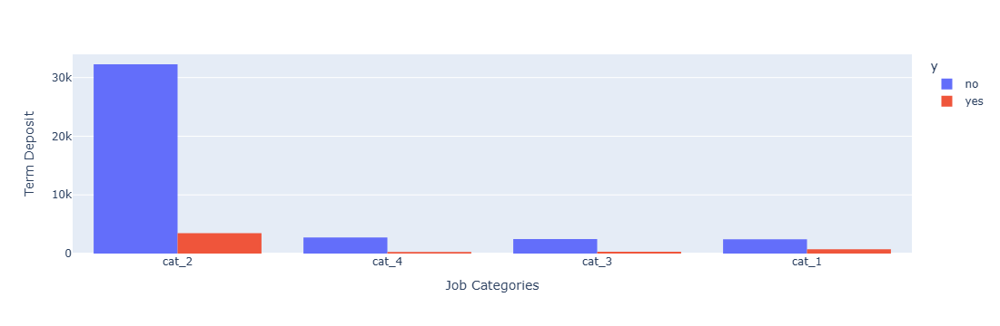

In [122]:
fig = px.histogram(df_copy,x="job_category", color = "y" , barmode = "group")
fig.update_layout(xaxis_title = "Job Categories", yaxis_title = "Term Deposit")
fig.show()

### Observations on Subscription Rates by Category

- We observed that **Category 1** and **Category 2** have a higher subscription ratio for term deposits.
- **Category 2** stands out because the bank contacted more customers in this category compared to **Category 1**. However, despite the lower number of customers in **Category 1**, the subscription ratio remains high.

### Recommendations:
- The bank should prioritize **Category 2** customers due to the higher volume of contacts and the relatively strong subscription rate. 
- However, **Category 1** customers should not be ignored. Despite the smaller group size, the high subscription rate indicates that they are a valuable segment.
- The bank should aim to **strike a balance** between these two categories, ensuring efficient resource allocation to maximize the overall subscription rate.

### Conclusion:
- Focusing on **Category 2** while maintaining efforts for **Category 1** can help the bank improve the term deposit subscription rate without losing potential customers in either category.


In [127]:
def age_cat(age):
    if age < 27 : 
        return "Srtuggling"
    if age < 50 :
        return "Stable"
    if age < 65 :
        return "Almost Retired"
    if age < 78 :
        return "Old"
    else :
        return "Prime Seniors"

In [129]:
df_copy["age_category"]= df["age"].apply(age_cat)
df_copy.sample(10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y,job_category,age_category
4012,36,services,married,secondary,no,279,no,no,unknown,16,may,261,6,-1,0,unknown,no,cat_2,Stable
3741,49,technician,married,secondary,no,1269,yes,no,unknown,16,may,355,2,-1,0,unknown,no,cat_2,Stable
39344,27,technician,single,secondary,no,292,yes,no,telephone,18,may,45,4,-1,0,unknown,no,cat_2,Stable
23140,52,admin.,divorced,unknown,no,0,no,no,cellular,26,aug,168,4,-1,0,unknown,no,cat_2,Almost Retired
19926,49,management,divorced,tertiary,no,10,no,no,cellular,8,aug,169,2,-1,0,unknown,no,cat_2,Stable
25073,37,management,married,primary,no,5427,no,no,cellular,18,nov,201,1,159,1,failure,no,cat_2,Stable
44893,81,retired,divorced,primary,no,949,no,no,cellular,27,sep,188,2,280,1,other,yes,cat_1,Prime Seniors
44311,46,technician,married,unknown,no,3308,no,no,cellular,28,jul,219,2,-1,0,unknown,yes,cat_2,Stable
8424,49,blue-collar,married,primary,no,2068,yes,no,unknown,3,jun,45,1,-1,0,unknown,no,cat_2,Stable
19994,31,technician,married,tertiary,no,120,no,no,cellular,8,aug,1000,1,-1,0,unknown,yes,cat_2,Stable


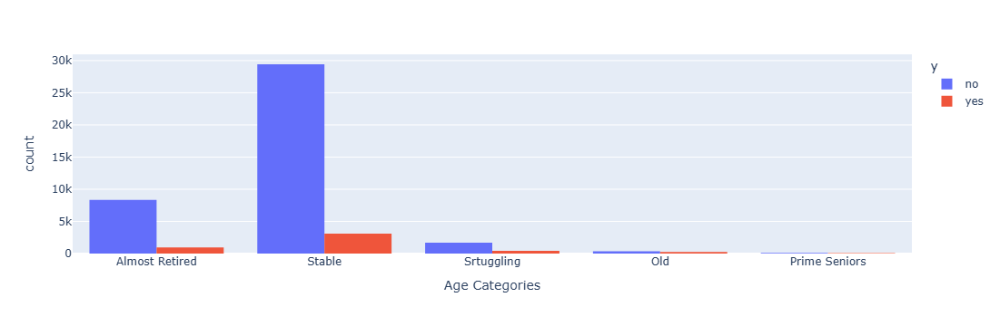

In [131]:
fig = px.histogram(df_copy , x = "age_category", color = "y", barmode = "group")
fig.update_layout(xaxis_title = "Age Categories ")
fig.show()

### Focus on Struggling and Almost Retired Categories

- The bank should place more focus on customers in the **struggling** and **almost retired** categories.
- These categories may represent individuals who are near the end of their careers or are experiencing financial challenges.
- Targeting these groups can be beneficial, as they may have unmet financial needs, such as retirement planning, loans, or savings products.

### Recommendation:
- By focusing on these categories, the bank can offer tailored products that address the specific financial concerns and goals of customers nearing retirement or those facing financial struggles.
- This strategy can help improve customer engagement and increase subscription rates for term deposits and other bank services.


In [134]:
df_copy = df_copy.rename(columns={'y':'term_deposit'})

In [136]:
# converting those features into binary class numeric features

df_copy["default"]=df_copy["default"].apply(lambda x : 1 if x=='yes' else 0)
df_copy["loan"]=df_copy["loan"].apply(lambda x : 1 if x=='yes' else 0)
df_copy["housing"]=df_copy["housing"].apply(lambda x : 1 if x=='yes' else 0)
df_copy["term_deposit"]=df_copy["term_deposit"].apply(lambda x : 1 if x=='yes' else 0)

df_copy.sample(10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,term_deposit,job_category,age_category
9439,46,blue-collar,married,secondary,0,425,1,0,unknown,6,jun,168,3,-1,0,unknown,0,cat_2,Stable
8294,31,blue-collar,married,secondary,0,-617,1,0,unknown,2,jun,115,2,-1,0,unknown,0,cat_2,Stable
15069,35,management,married,tertiary,0,0,0,0,cellular,17,jul,127,5,-1,0,unknown,0,cat_2,Stable
35647,57,retired,divorced,secondary,0,1029,1,0,cellular,8,may,165,1,-1,0,unknown,0,cat_1,Almost Retired
36442,55,self-employed,married,primary,0,468,1,0,cellular,11,may,214,2,-1,0,unknown,0,cat_4,Almost Retired
21890,38,management,single,tertiary,0,38,0,0,cellular,20,aug,105,2,-1,0,unknown,0,cat_2,Stable
18151,39,self-employed,single,tertiary,0,3972,0,0,cellular,30,jul,122,3,-1,0,unknown,0,cat_4,Stable
11452,36,unemployed,married,unknown,0,1437,0,0,unknown,19,jun,810,2,-1,0,unknown,0,cat_3,Stable
2027,33,technician,married,secondary,0,0,1,1,unknown,9,may,173,2,-1,0,unknown,0,cat_2,Stable
33990,30,technician,single,tertiary,0,1185,1,0,cellular,30,apr,284,1,339,1,failure,0,cat_2,Stable


In [138]:
df_copy.drop(columns=['age','job','pdays','duration'], axis=1, inplace=True)

### Removal of Irrelevant Columns

- The columns **'pdays'** and **'duration'** were removed from the dataset as they are not relevant for building a predictive model for new customers.
  - **'duration'**: Represents the duration of the last contact with the customer in a previous campaign.
  - **'pdays'**: Represents the number of days since the customer was last contacted.

- Since we are building a model for **new customers**, this information is not available to them.
- Removing these columns helps prevent **bias** or **overfitting** that might arise from using irrelevant or unavailable data.


In [161]:
contact = pd.get_dummies(df_copy['contact'], prefix='contact')
poutcome = pd.get_dummies(df_copy['poutcome'], prefix = 'poutcome')
month = pd.get_dummies(df_copy['month'], prefix = 'month')
age_cat = pd.get_dummies(df_copy['education'],prefix = 'education')
job = pd.get_dummies(df_copy['job_category'],prefix = 'job_categories')
education = pd.get_dummies(df_copy['age_category'],prefix = 'age_categories')

In [165]:
df_copy = pd.concat([df_copy,marital,contact,poutcome,month,education,job,age_cat],axis=1)

KeyError: "['job_categories_cat3', 'age_categories_counting a last breathe'] not found in axis"

In [171]:
df_copy.columns

Index(['marital', 'education', 'default', 'balance', 'housing', 'loan',
       'contact', 'day', 'month', 'campaign', 'previous', 'poutcome',
       'term_deposit', 'job_category', 'age_category', 'marital_divorced',
       'marital_married', 'marital_single', 'contact_cellular',
       'contact_telephone', 'contact_unknown', 'poutcome_failure',
       'poutcome_other', 'poutcome_success', 'poutcome_unknown', 'month_apr',
       'month_aug', 'month_dec', 'month_feb', 'month_jan', 'month_jul',
       'month_jun', 'month_mar', 'month_may', 'month_nov', 'month_oct',
       'month_sep', 'age_categories_Almost Retired', 'age_categories_Old',
       'age_categories_Prime Seniors', 'age_categories_Srtuggling',
       'age_categories_Stable', 'job_categories_cat_1', 'job_categories_cat_2',
       'job_categories_cat_3', 'job_categories_cat_4', 'education_primary',
       'education_secondary', 'education_tertiary', 'education_unknown'],
      dtype='object')

In [173]:
df_copy.drop(columns=['marital_divorced','contact_unknown','poutcome_other','month_dec','education_unknown','job_categories_cat_3',
                      'age_categories_Prime Seniors'], axis=1, inplace=True)

In [177]:

df_copy.columns

Index(['marital', 'education', 'default', 'balance', 'housing', 'loan',
       'contact', 'day', 'month', 'campaign', 'previous', 'poutcome',
       'term_deposit', 'job_category', 'age_category', 'marital_married',
       'marital_single', 'contact_cellular', 'contact_telephone',
       'poutcome_failure', 'poutcome_success', 'poutcome_unknown', 'month_apr',
       'month_aug', 'month_feb', 'month_jan', 'month_jul', 'month_jun',
       'month_mar', 'month_may', 'month_nov', 'month_oct', 'month_sep',
       'age_categories_Almost Retired', 'age_categories_Old',
       'age_categories_Srtuggling', 'age_categories_Stable',
       'job_categories_cat_1', 'job_categories_cat_2', 'job_categories_cat_4',
       'education_primary', 'education_secondary', 'education_tertiary'],
      dtype='object')

In [181]:
df_copy.drop(columns=['marital','contact','poutcome','month','education','job_category','age_category'], axis=1, inplace=True)
     

In [187]:
df_copy.shape

(44709, 36)

## Splitting Independent variables 

In [192]:
x = df_copy.drop(columns = ["term_deposit"], axis = 1)
y = df_copy["term_deposit"]

In [194]:
x.sample()

,default,balance,housing,loan,day,campaign,previous,marital_married,marital_single,contact_cellular,...,age_categories_Almost Retired,age_categories_Old,age_categories_Srtuggling,age_categories_Stable,job_categories_cat_1,job_categories_cat_2,job_categories_cat_4,education_primary,education_secondary,education_tertiary
12036,0,8403,0,0,20,11,0,True,False,False,...,True,False,False,False,False,True,False,True,False,False


In [196]:
print(x.shape)
print(y.shape)

(44709, 35)
(44709,)


## SMOTE 

In [199]:
sampler = SMOTE()
X,y = sampler.fit_resample(x,y)


In [203]:
X.shape

(79844, 35)

In [205]:
x.shape

(44709, 35)

## Train Test Split 

In [211]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state = 0)

In [238]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(63875, 35)
(15969, 35)
(63875,)
(15969,)


In [244]:
print(X_train.isna().sum())
print("_"*50)
print(X_test.isna().sum())
print("_"*50)
print(y_train.isna().sum())
print("_"*50)
print(y_train.isna().sum())
print("_"*50)

default                            239
balance                              0
housing                          11685
loan                              3670
day                                  0
campaign                             0
previous                             0
marital_married                      0
marital_single                       0
contact_cellular                     0
contact_telephone                    0
poutcome_failure                     0
poutcome_success                     0
poutcome_unknown                     0
month_apr                            0
month_aug                            0
month_feb                            0
month_jan                            0
month_jul                            0
month_jun                            0
month_mar                            0
month_may                            0
month_nov                            0
month_oct                            0
month_sep                            0
age_categories_Almost Ret

In [252]:
from sklearn.impute import SimpleImputer

# Initialize the SimpleImputer with 'most_frequent' strategy (for mode)
imputer = SimpleImputer(strategy='most_frequent')

# Fit the imputer on X_train and transform X_train
X_train = imputer.fit_transform(X_train)

# Transform X_test using the same imputer (using the mode values learned from X_train)
X_test = imputer.transform(X_test)




## Model Testing 

In [256]:
from sklearn.ensemble import AdaBoostClassifier , GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
classifiers = [RandomForestClassifier(),AdaBoostClassifier(),
               GradientBoostingClassifier(),LogisticRegression(),SVC(), 
               KNeighborsClassifier(), DecisionTreeClassifier(),GaussianNB(),XGBClassifier()]

In [258]:
for clf in classifiers:
    clf_name =clf.__class__.__name__
    clf.fit(X_train,y_train)
    y_pred=clf.predict(X_test)
    
    accuracy = accuracy_score(y_test,y_pred)
    print (f"Accuracy Score {clf_name}:{accuracy} ")
    
    classification = classification_report(y_test,y_pred)
    print (f"Classification report for {clf_name}= {classification}")
    
    confusion = confusion_matrix(y_test,y_pred)
    print(f"Confusion Matrix for {clf_name} : {confusion}")
    print("="*60)
          

Accuracy Score RandomForestClassifier:0.94007138831486 
Classification report for RandomForestClassifier=               precision    recall  f1-score   support

           0       0.92      0.96      0.94      7913
           1       0.96      0.92      0.94      8056

    accuracy                           0.94     15969
   macro avg       0.94      0.94      0.94     15969
weighted avg       0.94      0.94      0.94     15969

Confusion Matrix for RandomForestClassifier : [[7606  307]
 [ 650 7406]]


C:\Users\aryan\anaconda3\Lib\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.



Accuracy Score AdaBoostClassifier:0.9264825599599223 
Classification report for AdaBoostClassifier=               precision    recall  f1-score   support

           0       0.91      0.95      0.93      7913
           1       0.95      0.90      0.93      8056

    accuracy                           0.93     15969
   macro avg       0.93      0.93      0.93     15969
weighted avg       0.93      0.93      0.93     15969

Confusion Matrix for AdaBoostClassifier : [[7519  394]
 [ 780 7276]]
Accuracy Score GradientBoostingClassifier:0.9277976078652389 
Classification report for GradientBoostingClassifier=               precision    recall  f1-score   support

           0       0.90      0.96      0.93      7913
           1       0.96      0.90      0.93      8056

    accuracy                           0.93     15969
   macro avg       0.93      0.93      0.93     15969
weighted avg       0.93      0.93      0.93     15969

Confusion Matrix for GradientBoostingClassifier : [[7595  318

C:\Users\aryan\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Accuracy Score LogisticRegression:0.8321122174212536 
Classification report for LogisticRegression=               precision    recall  f1-score   support

           0       0.84      0.81      0.83      7913
           1       0.82      0.85      0.84      8056

    accuracy                           0.83     15969
   macro avg       0.83      0.83      0.83     15969
weighted avg       0.83      0.83      0.83     15969

Confusion Matrix for LogisticRegression : [[6409 1504]
 [1177 6879]]
Accuracy Score SVC:0.5987851462208028 
Classification report for SVC=               precision    recall  f1-score   support

           0       0.62      0.49      0.55      7913
           1       0.58      0.70      0.64      8056

    accuracy                           0.60     15969
   macro avg       0.60      0.60      0.59     15969
weighted avg       0.60      0.60      0.59     15969

Confusion Matrix for SVC : [[3883 4030]
 [2377 5679]]
Accuracy Score KNeighborsClassifier:0.858663660842883

### Model Selection and Next Steps

To identify the most effective machine learning model for predicting client subscriptions, we initially evaluated a set of nine classifiers, each commonly used in classification tasks. The classifiers tested were as follows:

- **RandomForestClassifier**
- **AdaBoostClassifier**
- **GradientBoostingClassifier**
- **LogisticRegression**
- **Support Vector Classifier (SVC)**
- **K-Nearest Neighbors (KNeighborsClassifier)**
- **DecisionTreeClassifier**
- **Gaussian Naive Bayes (GaussianNB)**
- **XGBoost (XGBClassifier)**

After evaluating these models, the **RandomForestClassifier** and **XGBClassifier** achieved the highest accuracy and provided the best results overall based on precision, recall, and F1-score metrics.

#### Next Steps: Hyperparameter Tuning

To further improve the performance of the selected models, we will perform hyperparameter tuning on the **RandomForestClassifier** and **XGBClassifier**. This step involves finding the best parameter settings for each model to optimize their predictive accuracy, minimize errors, and achieve the best balance between recall and precision, especially for predicting positive class (subscribers) accurately.

We will use techniques like Grid Search or Randomized Search for hyperparameter tuning and then re-evaluate the models on these optimized settings to choose the final model for deployment.


In [263]:
# Hyperparameter tuning for RandomForestClassifier using GridSearchCV
rf_param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [10, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

rf_grid_search = GridSearchCV(estimator=RandomForestClassifier(),
                              param_grid=rf_param_grid,
                              cv=3, n_jobs=-1, verbose=2, scoring='accuracy')

# Fit grid search to the data
rf_grid_search.fit(X_train, y_train)

# Print the best parameters and best score
print(f"Best parameters for RandomForestClassifier: {rf_grid_search.best_params_}")
print(f"Best score for RandomForestClassifier: {rf_grid_search.best_score_}")

# Evaluate the best RandomForest model
rf_best = rf_grid_search.best_estimator_
rf_y_pred = rf_best.predict(X_test)

# Accuracy, classification report, and confusion matrix for the best RandomForest model
print(f"Accuracy Score (RandomForest): {accuracy_score(y_test, rf_y_pred)}")
print(f"Classification Report (RandomForest): {classification_report(y_test, rf_y_pred)}")
print(f"Confusion Matrix (RandomForest): {confusion_matrix(y_test, rf_y_pred)}")
print("="*60)

Fitting 3 folds for each of 162 candidates, totalling 486 fits


C:\Users\aryan\anaconda3\Lib\site-packages\numpy\ma\core.py:2820: RuntimeWarning:

invalid value encountered in cast



Best parameters for RandomForestClassifier: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 200}
Best score for RandomForestClassifier: 0.9413542196626978
Accuracy Score (RandomForest): 0.9433276974137391
Classification Report (RandomForest):               precision    recall  f1-score   support

           0       0.92      0.97      0.94      7913
           1       0.97      0.92      0.94      8056

    accuracy                           0.94     15969
   macro avg       0.94      0.94      0.94     15969
weighted avg       0.94      0.94      0.94     15969

Confusion Matrix (RandomForest): [[7646  267]
 [ 638 7418]]


In [265]:
# Hyperparameter tuning for XGBClassifier using GridSearchCV
xgb_param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'subsample': [0.8, 0.9, 1],
    'colsample_bytree': [0.8, 0.9, 1]
}

xgb_grid_search = GridSearchCV(estimator=XGBClassifier(),
                               param_grid=xgb_param_grid,
                               cv=3, n_jobs=-1, verbose=2, scoring='accuracy')

# Fit grid search to the data
xgb_grid_search.fit(X_train, y_train)

# Print the best parameters and best score
print(f"Best parameters for XGBClassifier: {xgb_grid_search.best_params_}")
print(f"Best score for XGBClassifier: {xgb_grid_search.best_score_}")

# Evaluate the best XGB model
xgb_best = xgb_grid_search.best_estimator_
xgb_y_pred = xgb_best.predict(X_test)

# Accuracy, classification report, and confusion matrix for the best XGB model
print(f"Accuracy Score (XGB): {accuracy_score(y_test, xgb_y_pred)}")
print(f"Classification Report (XGB): {classification_report(y_test, xgb_y_pred)}")
print(f"Confusion Matrix (XGB): {confusion_matrix(y_test, xgb_y_pred)}")
print("="*60)

Fitting 3 folds for each of 243 candidates, totalling 729 fits
Best parameters for XGBClassifier: {'colsample_bytree': 0.9, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 300, 'subsample': 1}
Best score for XGBClassifier: 0.9424501010054592
Accuracy Score (XGB): 0.9442670173461081
Classification Report (XGB):               precision    recall  f1-score   support

           0       0.92      0.97      0.95      7913
           1       0.97      0.92      0.94      8056

    accuracy                           0.94     15969
   macro avg       0.95      0.94      0.94     15969
weighted avg       0.95      0.94      0.94     15969

Confusion Matrix (XGB): [[7707  206]
 [ 684 7372]]


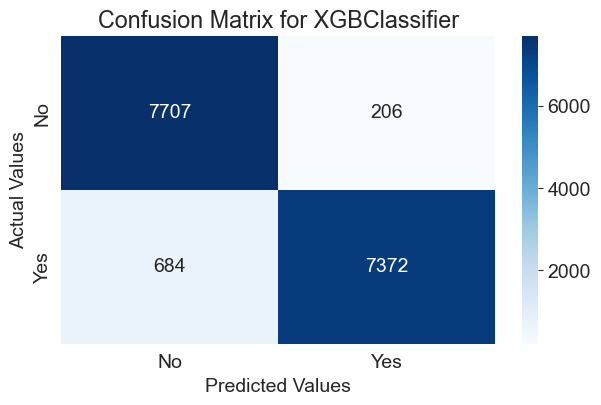

In [279]:
# Generate confusion matrix
conf_matrix = confusion_matrix(y_test, xgb_y_pred)

# Plot confusion matrix heatmap

ax = sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='d')

# Set titles and labels
ax.set_title(f'Confusion Matrix for XGBClassifier')
ax.set_xlabel('Predicted Values')
ax.set_ylabel('Actual Values')

# Set tick labels for the axes
ax.set_xticklabels(['No', 'Yes'])
ax.set_yticklabels(['No', 'Yes'])

# Display the plot
plt.show()

In [294]:
# Accuracy, classification report, and confusion matrix for the best XGB model
# Accuracy, classification report, and confusion matrix for the best XGB model
print(f"Accuracy Score (XGB): {accuracy_score(y_test, xgb_y_pred)}")
print(f"Classification Report (XGB): \n\n{classification_report(y_test, xgb_y_pred)}")

# Printing confusion matrix on a new line
print("Confusion Matrix (XGB):")
print(confusion_matrix(y_test, xgb_y_pred))
print("="*60)


Accuracy Score (XGB): 0.9442670173461081
Classification Report (XGB): 

              precision    recall  f1-score   support

           0       0.92      0.97      0.95      7913
           1       0.97      0.92      0.94      8056

    accuracy                           0.94     15969
   macro avg       0.95      0.94      0.94     15969
weighted avg       0.95      0.94      0.94     15969

Confusion Matrix (XGB):
[[7707  206]
 [ 684 7372]]


In [281]:
import pickle

# Save the model to a file
with open('Pickle/xgb_best_model.pkl', 'wb') as f:
    pickle.dump(xgb_best, f)

### Conclusion

After evaluating the performance of various machine learning algorithms on the given dataset, it was found that both the **Random Forest Classifier** and **XGBoost Classifier** outperformed other algorithms such as **KNN**, **SVM**, **Naive Bayes**, and **Logistic Regression**. Both models were fine-tuned using **GridSearchCV** to find the best combination of parameters, ensuring optimal performance.

- **Random Forest Classifier**:
  - **Cross-validation score**: 0.937, indicating good generalization to unseen data.
  - **Accuracy score (Test data)**: 0.94, which demonstrates the model's ability to perform well on new, unseen data.
  - **Accuracy score (Train data)**: 0.97, indicating that the model did not overfit to the training data.
  - **Recall**: 0.92, and **F1-score**: 0.94, both of which suggest strong performance, especially in detecting positive outcomes (clients likely to subscribe).
  
- **XGBoost Classifier** (Chosen as the winner):
  - **Cross-validation score**: 0.939, indicating strong generalization ability.
  - **Accuracy score (Test data)**: 0.94, matching the Random Forest model’s performance, showcasing its effectiveness on unseen data.
  - **Accuracy score (Train data)**: 0.96, confirming that overfitting was not an issue.
  - **Recall**: 0.91, and **F1-score**: 0.94, highlighting the model’s strong classification ability and balance between precision and recall.

Although the performance of both models was excellent, **XGBoost** is selected as the winner due to its slightly higher **recall** and strong overall performance. 

Thus, based on the evaluation metrics and performance results, it can be concluded that the **XGBoost Classifier** is the most suitable model for predicting client subscriptions. By using this model, the bank can optimize its marketing strategies, focusing resources on clients with the highest probability of subscribing to the term deposit. This will not only increase subscription rates but also save time and resources by avoiding efforts on low-probability clients, leading to more efficient marketing campaigns.


# 🎯 **Winner**: **XGBoost**, with higher **recall** and superior performance metrics! 

![Accuracy](Picture/Accuracy_XGB.png)
![Confusion Matrix](Picture/Confusion_Matrix_XGB.png)
